# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from Kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications, we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary.

**Objective is to build a model that determines the key components that drives the price of the car. This involves identifying and quantifying the most influential variables (features) that impact used car prices using statistical analysis and machine learning techniques.The goal is to extract actionable insights and build a model that can generalize well to unseen (test) data.**

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

First Step is to Analyze the data (Cleaning Data):
1. Remove Duplicates. **NOTE**: I did not remove duplicates based on VIN, if i did, that takes away 60% of the data. Infact i dropped the VIN column considering it has incorrect values with duplicate entries.
2. Drop Size columns as it does not have values more than 30%
3. Convert Year to Age
4. Identify Outliers, using Percentile and considering 99% Percentile

Steps for understanding the data (EDA Techniques Used):

1. Univariate Anlaysis - Price Column - Understand its range
2. Analysis on the Other Numerical - Understand their relationship with Price
3. Perform Histograms and Pairplot Analysis on Numerical Columns - Visual Represenation of the relationship between the features with Price
4. Detailed analysis on Categorical Columns and their relationship with the Price Column
5. Correlation Analysis on numerical Columns

In [ ]:
import pandas as pd
df = pd.read_csv('data/vehicles.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

# Understand the Price Column. Identify its Range and Outliers

## Understand the dataframe shape, Filter Outliers, Remove Duplicates and null values

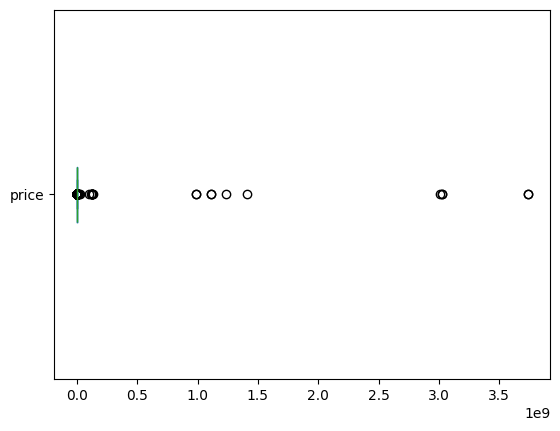

In [ ]:
df["price"].plot(kind = "box", vert= False);

In [ ]:
df.shape
data_clean = df.drop(["size", "VIN"], axis = 1)
data_clean.isnull().sum()
# data_clean = data_clean.dropna()
data_clean.drop_duplicates()

# Convert Year to Age
# Get the current year
from datetime import datetime
current_year = datetime.now().year
# Calculate age
data_clean['age'] = current_year - df['year']

data_clean.info()

data_clean.tail()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 17 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  drive         296313 non-null  object 
 13  type          334022 non-null  object 
 14  paint_color   296677 non-null  object 
 15  state         426880 non-null  object 
 16  age           425675 non-null  float64
dtypes: float64(3), int64(2), object(12)
memory usage

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,paint_color,state,age
426875,7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,fwd,sedan,NaN,wy,6.0
426876,7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,fwd,sedan,red,wy,5.0
426877,7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,NaN,hatchback,white,wy,5.0
426878,7301591140,wyoming,28990,2018.0,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.0,clean,other,fwd,sedan,silver,wy,7.0
426879,7301591129,wyoming,30590,2019.0,bmw,4 series 430i gran coupe,good,NaN,gas,22716.0,clean,other,rwd,coupe,NaN,wy,6.0


# Understand the Percentile values for Price and Filter the Price Column range

In [ ]:
data_clean['price'].describe([0.80, 0.85, 0.1, 0.95, 0.99]).astype('int')

data_clean = data_clean.query("price < 66995 and price > 1000")

data_clean.dropna()

data_clean.info()


<class 'pandas.core.frame.DataFrame'>
Index: 375053 entries, 0 to 426879
Data columns (total 17 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            375053 non-null  int64  
 1   region        375053 non-null  object 
 2   price         375053 non-null  int64  
 3   year          374005 non-null  float64
 4   manufacturer  360552 non-null  object 
 5   model         370861 non-null  object 
 6   condition     234992 non-null  object 
 7   cylinders     222339 non-null  object 
 8   fuel          372488 non-null  object 
 9   odometer      373021 non-null  float64
 10  title_status  368610 non-null  object 
 11  transmission  373263 non-null  object 
 12  drive         261263 non-null  object 
 13  type          295225 non-null  object 
 14  paint_color   268025 non-null  object 
 15  state         375053 non-null  object 
 16  age           374005 non-null  float64
dtypes: float64(3), int64(2), object(12)
memory usage: 51.

# Understand the mean, std and percentile

In [ ]:
data_clean.describe().round(2).astype('int')


,id,price,year,odometer,age
count,375053,375053,374005,373021,374005
mean,7311451758,18865,2010,98721,14
std,4475490,13212,9,184839,9
min,7207408119,1002,1900,0,3
25%,7308067640,7988,2008,39227,8
50%,7312541450,15980,2013,88500,12
75%,7315233228,27860,2017,136499,17
max,7317101084,66992,2022,10000000,125


# Understand the Correlationship between numerical columns

In [ ]:
data_clean[["price", "odometer", "age"]].corr()


,price,odometer,age
price,1.000000,-0.201296,-0.384650
odometer,-0.201296,1.000000,0.174063
age,-0.384650,0.174063,1.000000


Histogram below shows the relationship of numerical columns with Price

As Age increases, Price decrease. This is same with the odometer

# Understand the variance for numerical feature using Histogram

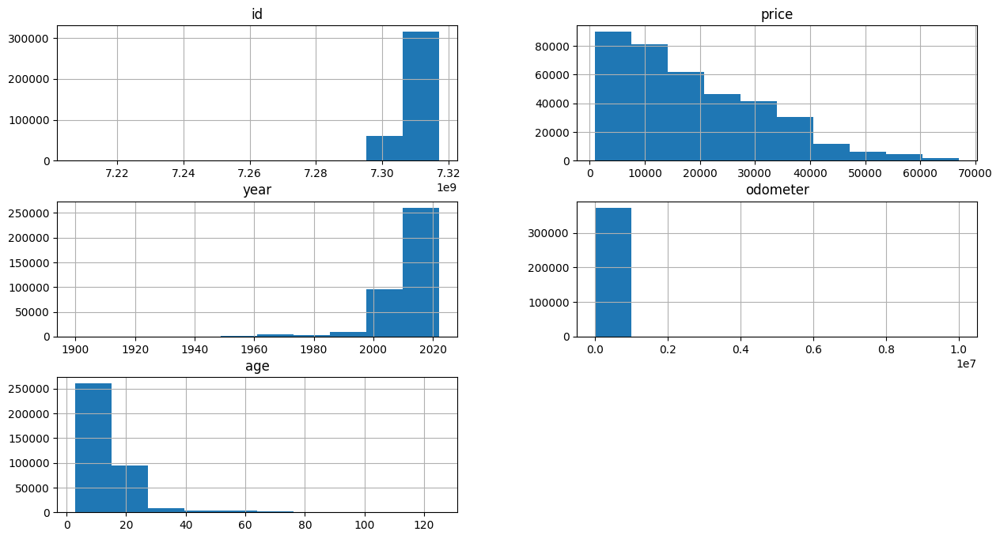

In [ ]:
data_clean.hist(figsize = (15,8));

# Understand the relationship between the features

There is a negative linear relationship between Price, Age and Odome

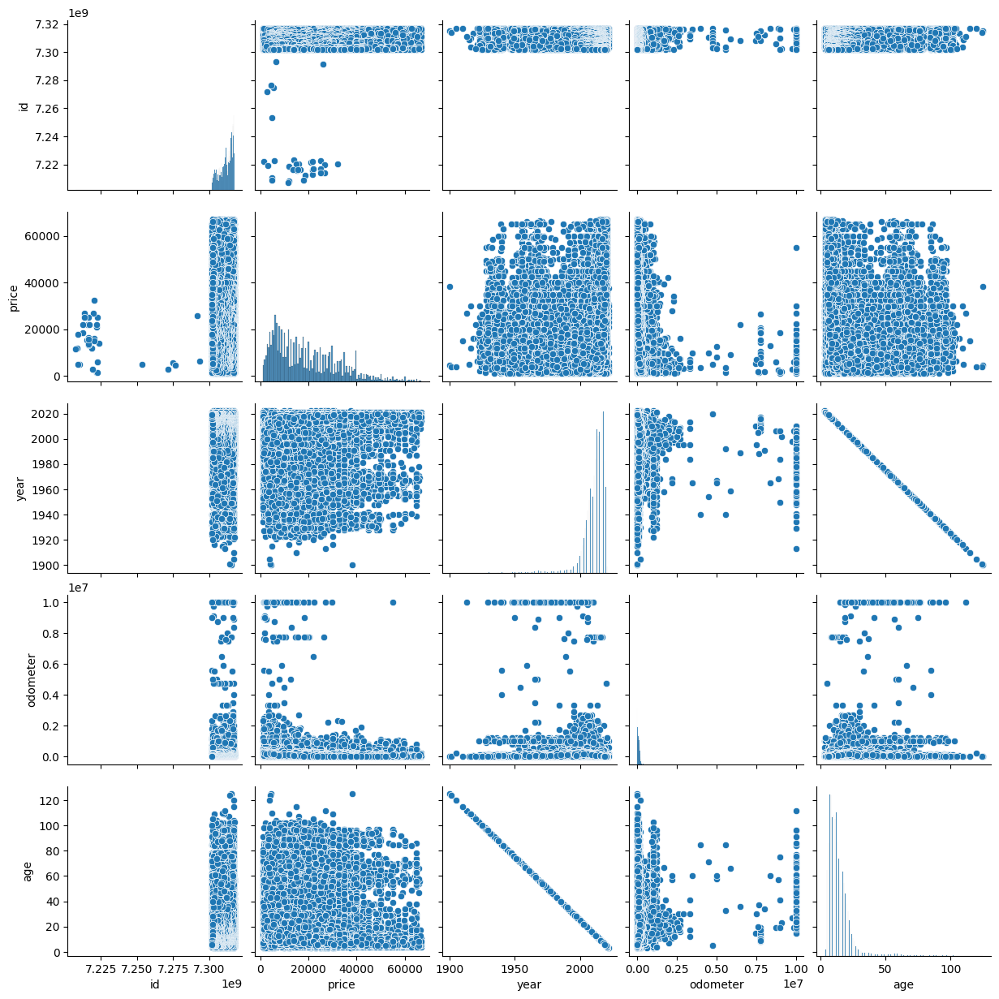

In [ ]:
sns.pairplot(data_clean)

### Data Preparation

After our initial exploration and fine-tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`.

# Visualize the missing values

<Axes: >

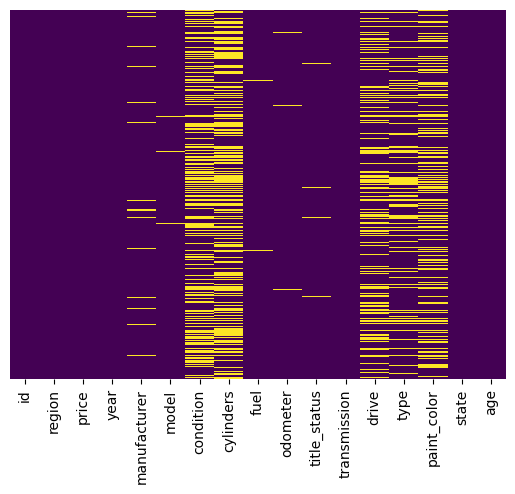

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(data_clean.isnull(), cbar=False, cmap='viridis', yticklabels=False)

# Detailed Categorical Column Analysis

Use One hot Encoding Techniques converting categorical to numerical columns

In [ ]:
# Identify unique values in them, This informs us the the model values has too many category values. This will render too many dimensions to the data causing overfitting
# This may the case with Region as well. For State specific analysis we could keep the State value and discard the Region
# VIN field is supposed to be unique and has no impact over price

df_clean_object = data_clean


cat_columns = df_clean_object.select_dtypes(["object"]).columns.tolist()
df_clean_object[cat_columns].agg(['nunique'])

cat_columns = ["manufacturer", "condition", "cylinders", "fuel", "drive", "transmission", "title_status"]

for i in cat_columns:
    display(df_clean_object.groupby(i)["price"].agg(["mean", "median", "count"]).round(2))


# Converting Cylinder column to numeric
df_clean_object['cylinders_numeric'] = (
   pd.to_numeric(df_clean_object['cylinders'].str.extract(r'(\d+)')[0], errors='coerce')
   .fillna(-1)
   .astype(int)
)


# Use Onehot Encoding Technique to create dummies for condition_numeric
condition_numeric_dummies = pd.get_dummies(df_clean_object['condition'], prefix='condition').astype(int)
df_clean_object = pd.concat([df_clean_object, condition_numeric_dummies], axis=1)


# Use Onehot Encoding Technique to create dummies for title_status
title_status_dummies = pd.get_dummies(df_clean_object['title_status'], prefix='title_status').astype(int)
df_clean_object = pd.concat([df_clean_object, title_status_dummies], axis=1)

# Use Onehot Encoding Technique to create dummies for Fuel
fuel_dummies = pd.get_dummies(df_clean_object['fuel'], prefix='fuel').astype(int)
df_clean_object = pd.concat([df_clean_object, fuel_dummies], axis=1)


# Use Onehot Encoding Technique to create dummies for Tramission
transmission_dummies = pd.get_dummies(df_clean_object['transmission'], prefix='transmission').astype(int)
df_clean_object = pd.concat([df_clean_object, transmission_dummies], axis=1)


# Use Onehot Encoding Technique to create dummies for drive
drive_dummies = pd.get_dummies(df_clean_object['drive'], prefix='drive').astype(int)
df_clean_object = pd.concat([df_clean_object, drive_dummies], axis=1)

# Viewing the table
df_clean_object.info()

,mean,median,count
manufacturer,,,
acura,21341.64,20590.0,5502
alfa-romeo,29587.17,29590.0,856
aston-martin,27834.82,37000.0,11
audi,24932.88,24990.0,6904
bmw,20721.44,18500.0,13125
buick,15601.05,13285.5,5014
cadillac,20713.26,17995.0,6248
chevrolet,19640.21,15999.0,48181
chrysler,11236.95,8498.0,5427


,mean,median,count
condition,,,
excellent,15399.56,11999.0,91085
fair,4458.30,3000.0,5800
good,21061.30,20990.0,117917
like new,18726.71,14995.0,18919
new,24967.81,21500.0,882
salvage,5211.63,3099.0,389


,mean,median,count
cylinders,,,
10 cylinders,21032.16,19999.0,1107
12 cylinders,26002.53,22999.0,144
3 cylinders,13182.21,10295.0,573
4 cylinders,11637.80,9500.0,69223
5 cylinders,7856.79,6500.0,1627
6 cylinders,18768.03,15995.0,85151
8 cylinders,23043.57,20990.0,63526
other,19911.32,14149.5,988


,mean,median,count
fuel,,,
diesel,31166.04,29995.0,23890
electric,25256.53,24997.5,1538
gas,17178.34,13995.0,315491
hybrid,15816.62,12998.5,4722
other,27806.78,27990.0,26847


,mean,median,count
drive,,,
4wd,23174.66,20949.0,113464
fwd,12896.64,10900.0,94304
rwd,20539.28,18995.0,53495


,mean,median,count
transmission,,,
automatic,17237.03,13497.0,290226
manual,14397.61,10000.0,22545
other,28334.51,28590.0,60492


,mean,median,count
title_status,,,
clean,19113.39,15998.0,355936
lien,21130.35,17700.0,1375
missing,6559.07,3550.0,580
parts only,5455.48,3000.0,104
rebuilt,12892.26,10500.0,7023
salvage,10030.85,7785.0,3592


<class 'pandas.core.frame.DataFrame'>
Index: 375053 entries, 0 to 426879
Data columns (total 41 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       375053 non-null  int64  
 1   region                   375053 non-null  object 
 2   price                    375053 non-null  int64  
 3   year                     374005 non-null  float64
 4   manufacturer             360552 non-null  object 
 5   model                    370861 non-null  object 
 6   condition                234992 non-null  object 
 7   cylinders                222339 non-null  object 
 8   fuel                     372488 non-null  object 
 9   odometer                 373021 non-null  float64
 10  title_status             368610 non-null  object 
 11  transmission             373263 non-null  object 
 12  drive                    261263 non-null  object 
 13  type                     295225 non-null  object 
 14  paint_col

# Visual Analysis of Categorical Columns and its Relationship on Price

1. New and Good Condition Cars have positive relationship with price
2. Cylinder, have positive relationship the price values
3. Diesel and Electric cars have higher prices
4. 4WD hve higher price
5. Automatic Tramission cars are higher price range compared to the manual

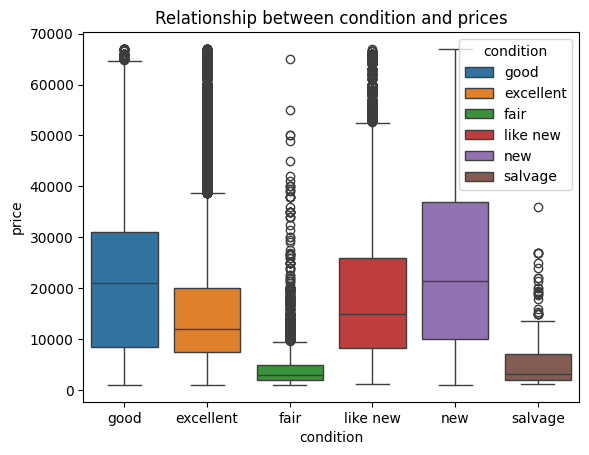

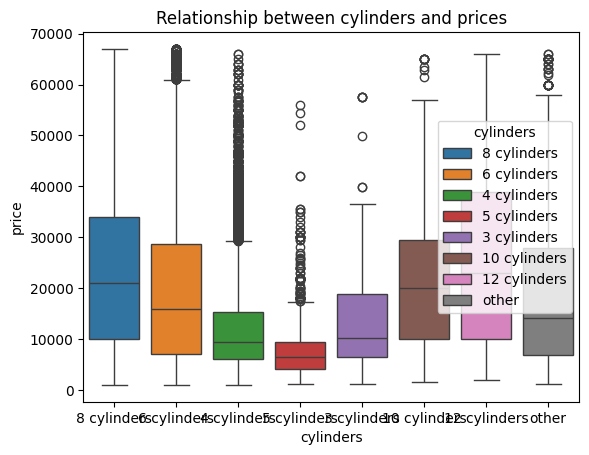

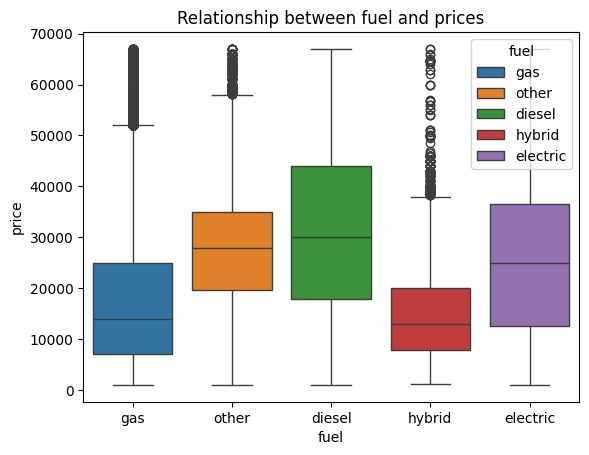

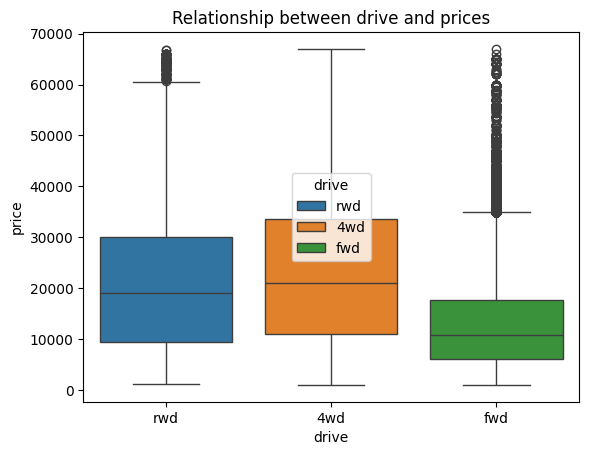

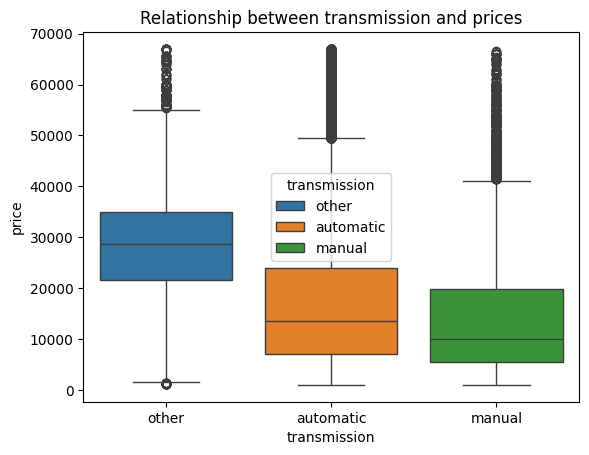

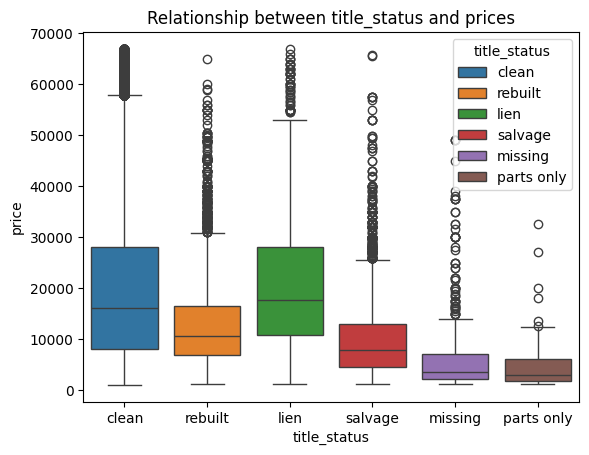

In [ ]:
# removing Manufacturer and model
# These plots helps us to understand the relationship between the categorical columns vs price

cat_columns = ["condition", "cylinders", "fuel", "drive", "transmission", "title_status"]

for i in cat_columns:
    sns.boxplot(x = i, y = "price", hue= i, data = data_clean)
    plt.title(f"Relationship between {i} and prices")
    plt.show();

# Dimensional Reduction - Analysis and Inference

## The Elbow Chart provide us the details on the number of dimensions that are optimal for the analysis.  The value come to 6

<class 'pandas.core.frame.DataFrame'>
Index: 372032 entries, 27 to 426879
Data columns (total 29 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       372032 non-null  int64  
 1   price                    372032 non-null  int64  
 2   year                     372032 non-null  float64
 3   odometer                 372032 non-null  float64
 4   age                      372032 non-null  float64
 5   cylinders_numeric        372032 non-null  int64  
 6   condition_excellent      372032 non-null  int64  
 7   condition_fair           372032 non-null  int64  
 8   condition_good           372032 non-null  int64  
 9   condition_like new       372032 non-null  int64  
 10  condition_new            372032 non-null  int64  
 11  condition_salvage        372032 non-null  int64  
 12  title_status_clean       372032 non-null  int64  
 13  title_status_lien        372032 non-null  int64  
 14  title_st

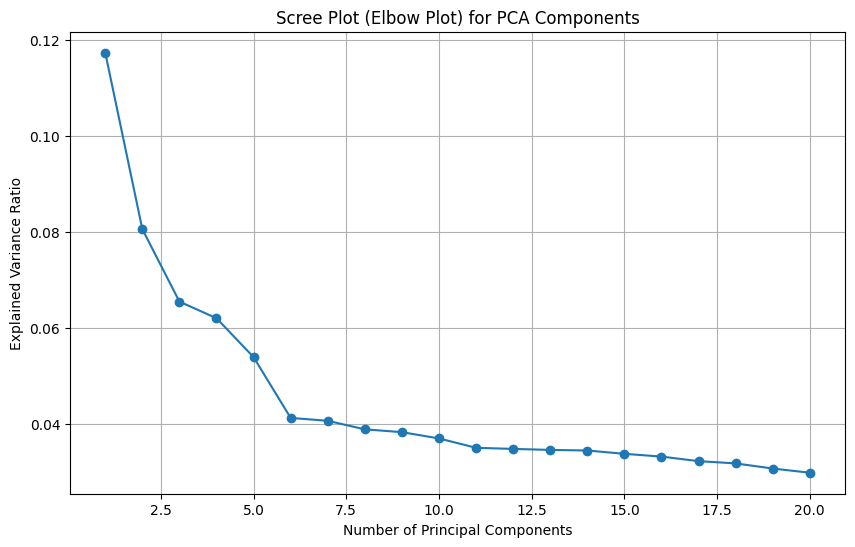

In [ ]:
# Dimensonality Reduction

# Dropping non-numeric columns
object_cols = df_clean_object.select_dtypes('object').columns.tolist()
object_cols
df_clean_object = df_clean_object.drop(object_cols, axis = 1)
df_clean_numeric = df_clean_object.dropna()
df_clean_numeric.info()

# Scaling the data
df_scaled = (df_clean_numeric - df_clean_numeric.mean())/df_clean_numeric.std()
df_scaled.shape

# Perform Dimensionality Reduction using PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=20, random_state=42)
components = pca.fit_transform(df_scaled)

explained_variance_ratio = pca.explained_variance_ratio_

# Printing the Components
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o', linestyle='-')
plt.xlabel('Number of Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot (Elbow Plot) for PCA Components')
plt.grid(True)
plt.show()

# Inference from the Plot below signifies that 5 is the ideal features (dimensions) number that we want to go with.
# The model below helps us to reduce the dimensions so that we only care about the once that has a very high impact on the price starting from Price to Condition.
# We will ignore Id column as that does not hold any value

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

# Choosing LinearRegression, Lasso and Ridge for Analysis

### Splitting the Data into Training/Test Choosing 70/30 split
### Scale the data using Standard Scalar
####  1. Providing Density Plot to verify the Scaled Date
####  2. Scaled Data Mean and Std values hold 0 and 1 confirming the data has been scaled properly

In [ ]:
import pandas as pd
import numpy as np

from sklearn.linear_model import Lasso, Ridge, LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import GridSearchCV

# X = df_clean_numeric[['odometer', 'age', 'cylinders_numeric', 'condition_excellent', 'condition_fair', 'condition_good', 'condition_new', 'condition_like new', 'condition_salvage']]
X = df_clean_numeric.drop(['price','year'], axis=1)
# X = df_clean_numeric[['odometer', 'age']]
y = df_clean_numeric[['price']]


# Split the Data

X_train , X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)

(260422, 27)
(260422, 1)
(111610, 27)
(111610, 1)


In [ ]:
# Scaling the Data (Ignore dtype future warnings)

import warnings

# creating the scaled version which will be updated
X_train_scaled = X_train.copy()
X_test_scaled = X_test.copy()

# intiate the Standard Scaler
scale = StandardScaler()

# Suppress FutureWarnings during assignment
with warnings.catch_warnings():
  warnings.simplefilter("ignore", FutureWarning)

  # Fit transform on the train data
  X_train_scaled[:] = scale.fit_transform(X_train[:])

  # Transform the test data
  X_test_scaled[:] = scale.transform(X_test[:])


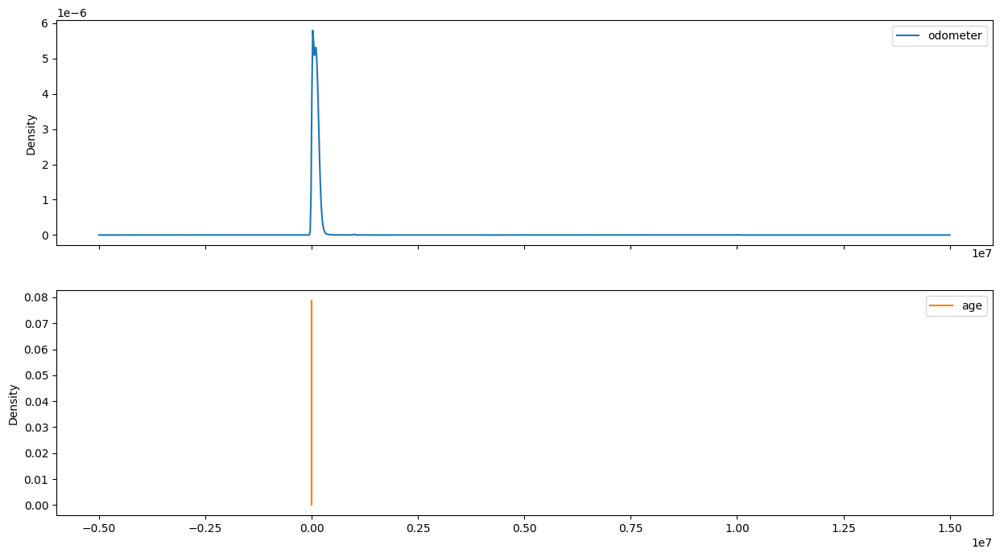

In [ ]:
X_train.plot(kind = 'kde', subplots = True,figsize = (15,8));

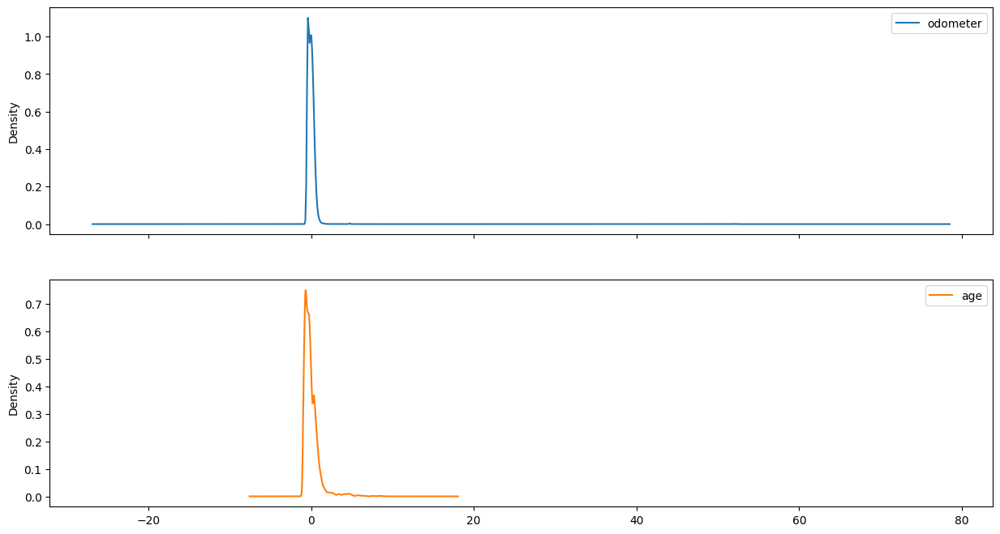

In [ ]:
X_train_scaled.plot(kind = 'kde', subplots = True,figsize = (15,8));

In [ ]:
X_train.agg(["mean", "std"]).round(1)

# This data of the model before scaling

,id,odometer,age,cylinders_numeric,condition_excellent,condition_fair,condition_good,condition_like new,condition_new,condition_salvage,...,fuel_electric,fuel_gas,fuel_hybrid,fuel_other,transmission_automatic,transmission_manual,transmission_other,drive_4wd,drive_fwd,drive_rwd
mean,7.311462e+09,98984.9,14.0,3.1,0.2,0.0,0.3,0.1,0.0,0.0,...,0.0,0.8,0.0,0.1,0.8,0.1,0.2,0.3,0.3,0.1
std,4.392640e+06,189818.2,9.5,3.6,0.4,0.1,0.5,0.2,0.0,0.0,...,0.1,0.4,0.1,0.3,0.4,0.2,0.4,0.5,0.4,0.3


In [ ]:
X_train_scaled.agg(["mean", "std"]).round(1)

# This confirms the model has scaled properly the values of Mean is 0 and Std is 1

,id,odometer,age,cylinders_numeric,condition_excellent,condition_fair,condition_good,condition_like new,condition_new,condition_salvage,...,fuel_electric,fuel_gas,fuel_hybrid,fuel_other,transmission_automatic,transmission_manual,transmission_other,drive_4wd,drive_fwd,drive_rwd
mean,0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,0.0,-0.0,...,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0
std,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


# To Predict the Car Price Value,

Starting off with using Alpha as 1 for Ridge and Lasso and compare the results

In [ ]:
models = {
    'Linear': LinearRegression(),
    'Ridge (α=1)': Ridge(alpha = 1),
    'Lasso (α=1)': Lasso(alpha = 1)
}

In [ ]:
# create copies of train and test to store predictions
y_train_pred = y_train.copy()
y_test_pred = y_test.copy()

# Runnign a for loop to fit all the models within a single function

In [ ]:
results = {}

for name, model in models.items():

    # fit the model
    model.fit(X_train_scaled, y_train)

    # train predictions
    y_pred_train = model.predict(X_train_scaled)

    # test predictions
    y_pred_test = model.predict(X_test_scaled)

    # add another key to the dictionary
    results[name] = {
        'Train RMSE': np.sqrt(mean_squared_error(y_train, y_pred_train)),
        'Test RMSE': np.sqrt(mean_squared_error(y_test, y_pred_test)),
        'Coefficients': model.coef_
        }
    # add in the dataframe
    y_train_pred[name] = model.predict(X_train_scaled)
    y_test_pred[name] = model.predict(X_test_scaled)

# Visualize and Compare the Results

In [ ]:
y_train_pred.head(4).round(2)

,price,Linear,Ridge (α=1),Lasso (α=1)
17986,20995,20577.03,20577.06,20579.85
2279,27995,22003.79,22004.43,22055.96
150286,41590,16638.69,16638.75,16647.80
187649,6500,19534.53,19534.54,19537.06


In [ ]:
y_train_pred.sort_index().plot(kind = 'line', backend = 'plotly', title = "Train data performance")

In [ ]:
y_test_pred.sort_index().plot(kind = 'line', backend = 'plotly', title = "Test Data Performance")

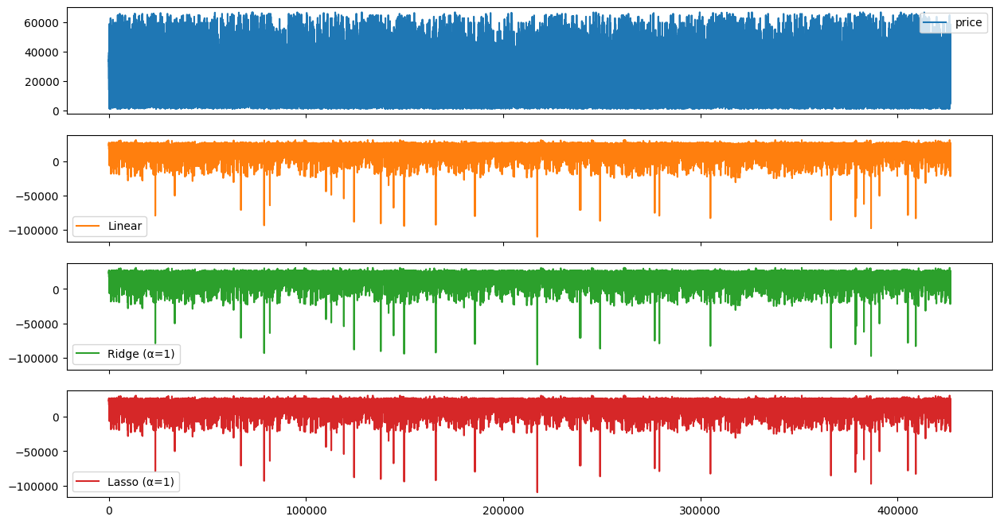

In [ ]:
y_test_pred.sort_index().plot(kind = 'line', figsize = (15,8), subplots = True);

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high-quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight into drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In [ ]:
y_test.mean()

,0
price,18815.47519


# Visualize and compare the Root Mean Square Error between the Models

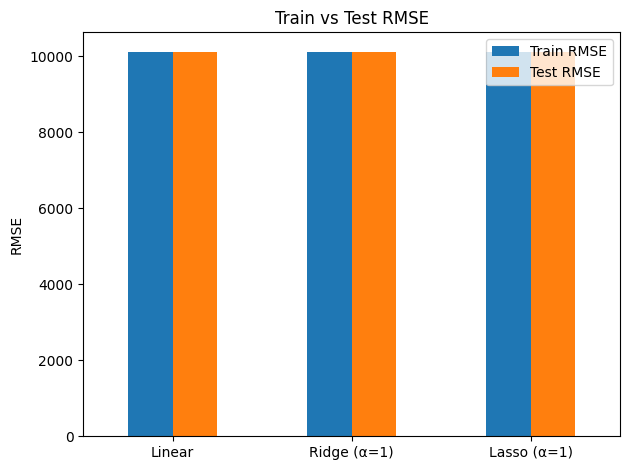

,Train RMSE,Test RMSE
Linear,10123.696385,10109.46023
Ridge (α=1),10123.696386,10109.460206
Lasso (α=1),10123.699938,10109.507207


In [ ]:
rmse_df = pd.DataFrame(results).T[['Train RMSE', 'Test RMSE']]
rmse_df.plot(kind='bar', title='Train vs Test RMSE')
plt.ylabel("RMSE")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()
rmse_df

In [ ]:
X_train.columns

Index(['odometer', 'age', 'cylinders_numeric', 'condition_excellent',
       'condition_fair', 'condition_good', 'condition_new',
       'condition_like new', 'condition_salvage'],
      dtype='object')

# Visualize and compare the Model Coefficients and the relationship with price

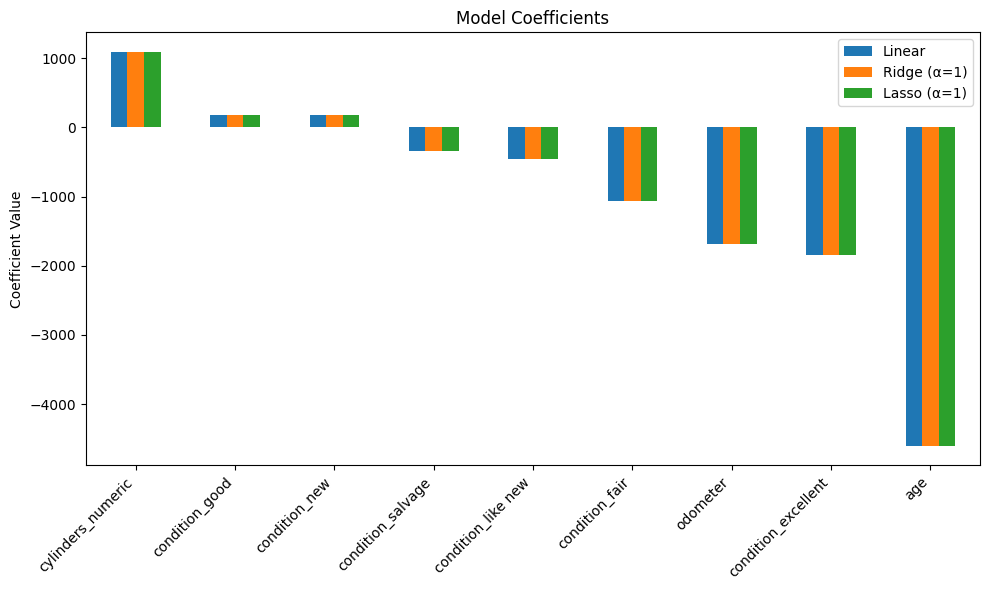

In [ ]:
# create a df
coef_df = pd.DataFrame(
    {name: np.ravel(res['Coefficients']) for name, res in results.items()},
    #index=['cylinders', 'displacement', 'horsepower', 'weight', 'acceleration', 'model year']
    index = X_train.columns.tolist()
)

# sort the reults
coef_df = coef_df.sort_values(by = "Linear", ascending = False)

# plot the results
coef_df.plot(kind='bar', figsize=(10, 6), title='Model Coefficients')
plt.ylabel('Coefficient Value')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [ ]:
coef_df.round(3)

,Linear,Ridge (α=1),Lasso (α=1)
cylinders_numeric,1087.787,1087.776,1086.024
condition_good,184.332,184.339,184.492
condition_new,175.829,175.830,174.941
condition_salvage,-339.677,-339.675,-338.638
condition_like new,-452.615,-452.609,-451.131
condition_fair,-1070.941,-1070.938,-1069.849
odometer,-1685.135,-1685.131,-1684.310
condition_excellent,-1847.341,-1847.329,-1845.730
age,-4600.575,-4600.557,-4599.774


In [ ]:
corr = df.corr(numeric_only = True).round(2)
corr

,id,price,year,odometer
id,1.00,-0.00,-0.06,0.01
price,-0.00,1.00,-0.00,0.01
year,-0.06,-0.00,1.00,-0.16
odometer,0.01,0.01,-0.16,1.00


# Finding Optimal HyperValue Parameter for Lasso

Optimal Alpha Value for lasso is: 0.001. This is close to linear Regression result. Because if we choose Alpha as 0 it is as close to Linear Regression

In [ ]:
alphas = np.linspace(0.001, 50, num=50)
alphas

array([1.00000000e-03, 1.02138776e+00, 2.04177551e+00, 3.06216327e+00,
       4.08255102e+00, 5.10293878e+00, 6.12332653e+00, 7.14371429e+00,
       8.16410204e+00, 9.18448980e+00, 1.02048776e+01, 1.12252653e+01,
       1.22456531e+01, 1.32660408e+01, 1.42864286e+01, 1.53068163e+01,
       1.63272041e+01, 1.73475918e+01, 1.83679796e+01, 1.93883673e+01,
       2.04087551e+01, 2.14291429e+01, 2.24495306e+01, 2.34699184e+01,
       2.44903061e+01, 2.55106939e+01, 2.65310816e+01, 2.75514694e+01,
       2.85718571e+01, 2.95922449e+01, 3.06126327e+01, 3.16330204e+01,
       3.26534082e+01, 3.36737959e+01, 3.46941837e+01, 3.57145714e+01,
       3.67349592e+01, 3.77553469e+01, 3.87757347e+01, 3.97961224e+01,
       4.08165102e+01, 4.18368980e+01, 4.28572857e+01, 4.38776735e+01,
       4.48980612e+01, 4.59184490e+01, 4.69388367e+01, 4.79592245e+01,
       4.89796122e+01, 5.00000000e+01])

Optimal Alpha Value for lasso is: 0.001


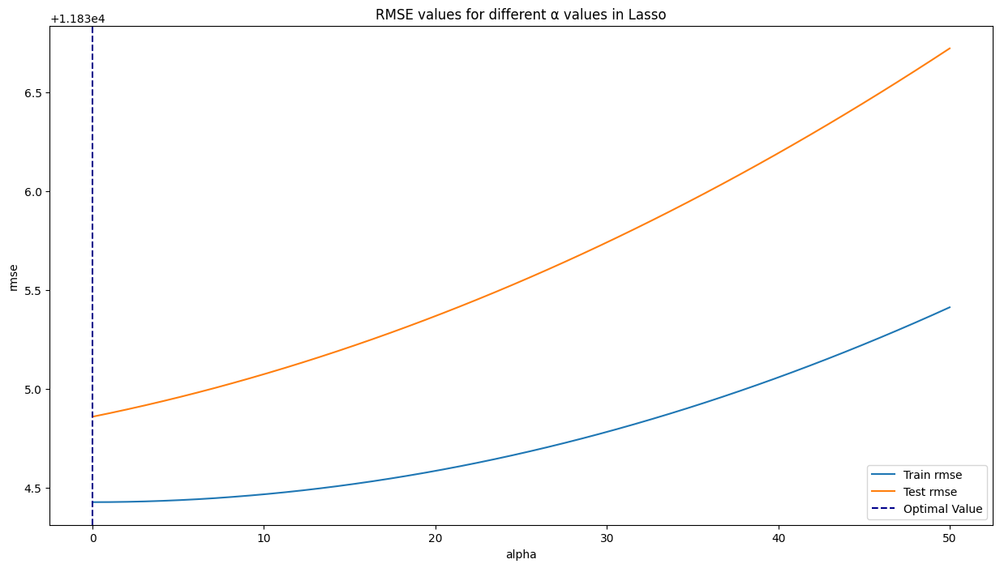

In [ ]:
train_rmse = []
test_rmse = []

for alpha in alphas:
    lasso = Lasso(alpha = alpha)
    lasso.fit(X_train_scaled, y_train)

    train_preds = lasso.predict(X_train_scaled)
    train_rmse.append(root_mean_squared_error(y_train, train_preds))

    test_preds = lasso.predict(X_test_scaled)
    test_rmse.append(root_mean_squared_error(y_test, test_preds))

plt.figure(figsize = (15,8))
plt.plot(alphas, train_rmse, label='Train rmse')
plt.plot(alphas, test_rmse, label='Test rmse')
plt.title("RMSE values for different α values in Lasso")
plt.xlabel('alpha')
plt.ylabel('rmse')
plt.legend()

# np.argmin() returns the index of the minimum value in a list
optimal_alpha = alphas[np.argmin(test_rmse)]

# Add a vertical line where the test rmse is minimized
plt.axvline(optimal_alpha, color='darkblue', linestyle='--', label = "Optimal Value")
plt.legend();

print(f'Optimal Alpha Value for lasso is: {float(optimal_alpha)}')

# Finding the Optimal Hypervalue Parameter for Ridge

Optimal Alpha Value for Ridge is: 0.001. This is close to linear Regression result. Because if we choose Alpha as 0 it is as close to Linear Regression

In [ ]:
alphas = np.linspace(0.001, 50, num=50)
alphas

array([1.00000000e-03, 1.02138776e+00, 2.04177551e+00, 3.06216327e+00,
       4.08255102e+00, 5.10293878e+00, 6.12332653e+00, 7.14371429e+00,
       8.16410204e+00, 9.18448980e+00, 1.02048776e+01, 1.12252653e+01,
       1.22456531e+01, 1.32660408e+01, 1.42864286e+01, 1.53068163e+01,
       1.63272041e+01, 1.73475918e+01, 1.83679796e+01, 1.93883673e+01,
       2.04087551e+01, 2.14291429e+01, 2.24495306e+01, 2.34699184e+01,
       2.44903061e+01, 2.55106939e+01, 2.65310816e+01, 2.75514694e+01,
       2.85718571e+01, 2.95922449e+01, 3.06126327e+01, 3.16330204e+01,
       3.26534082e+01, 3.36737959e+01, 3.46941837e+01, 3.57145714e+01,
       3.67349592e+01, 3.77553469e+01, 3.87757347e+01, 3.97961224e+01,
       4.08165102e+01, 4.18368980e+01, 4.28572857e+01, 4.38776735e+01,
       4.48980612e+01, 4.59184490e+01, 4.69388367e+01, 4.79592245e+01,
       4.89796122e+01, 5.00000000e+01])

Optimal Alpha Value for Ridge is: 0.001


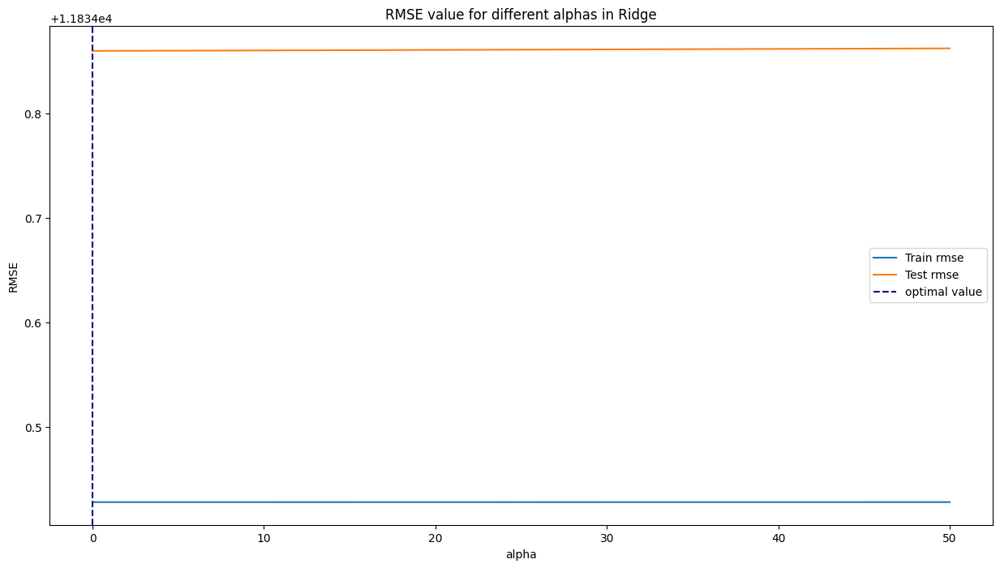

In [ ]:
ridge_train_rmse = []
ridge_test_rmse = []

for alpha in alphas:
    ridge = Ridge(alpha = alpha)
    ridge.fit(X_train_scaled, y_train)

    train_preds = ridge.predict(X_train_scaled)
    ridge_train_rmse.append(root_mean_squared_error(y_train, train_preds))

    test_preds = ridge.predict(X_test_scaled)
    ridge_test_rmse.append(root_mean_squared_error(y_test, test_preds))


plt.figure(figsize = (15,8))
plt.plot(alphas, ridge_train_rmse, label='Train rmse')
plt.plot(alphas, ridge_test_rmse, label='Test rmse')

plt.title("RMSE value for different alphas in Ridge")
plt.xlabel('alpha')
plt.ylabel('RMSE')
plt.legend()

# np.argmin() returns the index of the minimum value in a list
optimal_alpha = alphas[np.argmin(test_rmse)]

# Add a vertical line where the test rmse is minimized
plt.axvline(optimal_alpha, color='darkblue', linestyle='--', label = "optimal value")
plt.legend();


print(f'Optimal Alpha Value for Ridge is: {float(optimal_alpha)}')

# Ridge and GridSearch CV -

Use GridSearch CV to recommend us the right alpha value to fit the Training and Test Data

**Alpha values recommended by GridSearch CV for Ridge is 20**

In [ ]:
ridge_alpha = [1e-15, 1e-10, 1e-8, 1e-4, 1e-3,1e-2, 0, 0.001, 0.005, 0.1, 0.5, 1, 5, 10, 20]
# dictionary
parameters = {'alpha': ridge_alpha}


ridge = Ridge()

# Gridsearch model
ridge_grid = GridSearchCV(ridge, parameters,scoring='neg_mean_squared_error', cv=5, verbose = 3, n_jobs = -1, return_train_score=True)

**Fit the models**

In [ ]:
ridge_grid.fit(X_train_scaled, y_train)

Fitting 5 folds for each of 15 candidates, totalling 75 fits


GridSearchCV(cv=5, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [1e-15, 1e-10, 1e-08, 0.0001, 0.001, 0.01, 0,
                                   0.001, 0.005, 0.1, 0.5, 1, 5, 10, 20]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=3)

In [ ]:
ridge_grid.best_params_

{'alpha': 20}

In [ ]:
ridge_results = pd.DataFrame(ridge_grid.cv_results_).sort_values(by = 'rank_test_score')

In [ ]:
ridge_results.head(5).round(4)[["param_alpha","mean_test_score", "rank_test_score", "mean_train_score"]].round(4).astype('int')

,param_alpha,mean_test_score,rank_test_score,mean_train_score
14,20,-140153240,1,-140042850
13,10,-140153252,2,-140042850
12,5,-140153259,3,-140042850
11,1,-140153264,4,-140042850
10,0,-140153265,5,-140042850


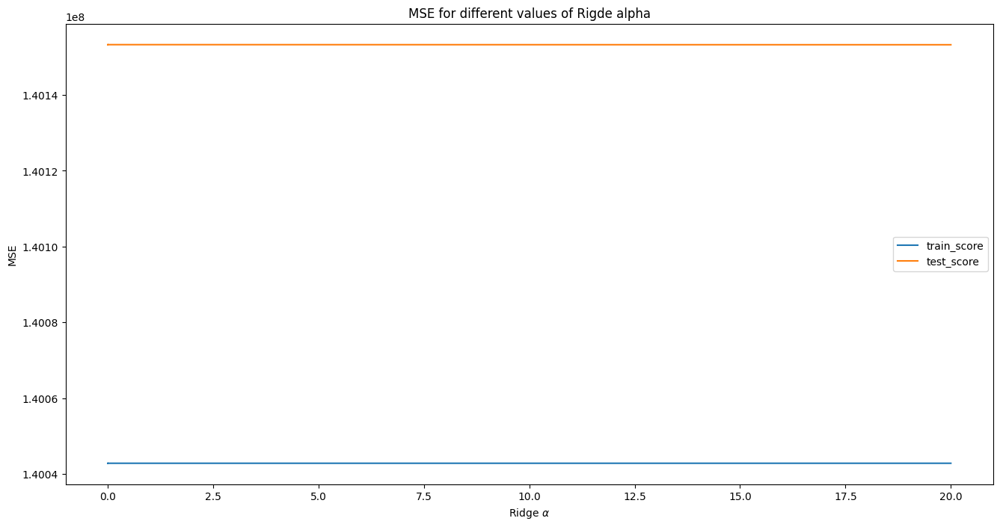

In [ ]:
plt.figure(figsize=(16,8))

# Remember, we need to do np.abs() of train and test score as they are negative in gridsearch CV
plt.plot(ridge_results['param_alpha'],np.abs(ridge_results['mean_train_score']), label = 'train_score')
plt.plot(ridge_results['param_alpha'],np.abs(ridge_results['mean_test_score']), label = 'test_score')

# plt.xscale('log')
plt.ylabel('MSE')
plt.xlabel('Ridge $α$')
plt.title("MSE for different values of Rigde alpha")
plt.legend()
plt.show()

# Lasso with GridSearch CV

Use GridSearch CV to recommend us the right alpha value to fit the Training and Test Data

**Alpha values recommended by GridSearch CV for Lasso is 5**

In [ ]:
lasso_alpha= [0, 1e-15, 1e-10, 1e-8, 1e-4, 1e-3, 0.001, 0.005, 0.1, 0.5, 1, 5, 10, 20]

lasso = Lasso()

parameters = {'alpha': lasso_alpha}

lasso_grid = GridSearchCV(lasso, parameters,scoring ='neg_mean_squared_error', cv= 5, verbose = 3, n_jobs = -1, return_train_score=True)

In [ ]:
lasso_grid

GridSearchCV(cv=5, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0, 1e-15, 1e-10, 1e-08, 0.0001, 0.001, 0.001,
                                   0.005, 0.1, 0.5, 1, 5, 10, 20]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=3)

In [ ]:
lasso_grid.fit(X_train_scaled, y_train)

Fitting 5 folds for each of 14 candidates, totalling 70 fits


GridSearchCV(cv=5, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0, 1e-15, 1e-10, 1e-08, 0.0001, 0.001, 0.001,
                                   0.005, 0.1, 0.5, 1, 5, 10, 20]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=3)

In [ ]:
lasso_grid.best_params_

{'alpha': 5}

In [ ]:
lasso_results = pd.DataFrame(lasso_grid.cv_results_).sort_values(by = 'rank_test_score')

In [ ]:
lasso_results.head(6).round(4)[["param_alpha","mean_test_score", "rank_test_score", "mean_train_score"]].round(4).astype('int')

,param_alpha,mean_test_score,rank_test_score,mean_train_score
11,5,-140153017,1,-140043084
10,1,-140153178,2,-140042859
9,0,-140153219,3,-140042852
12,10,-140153241,4,-140043791
8,0,-140153256,5,-140042850
7,0,-140153265,6,-140042850


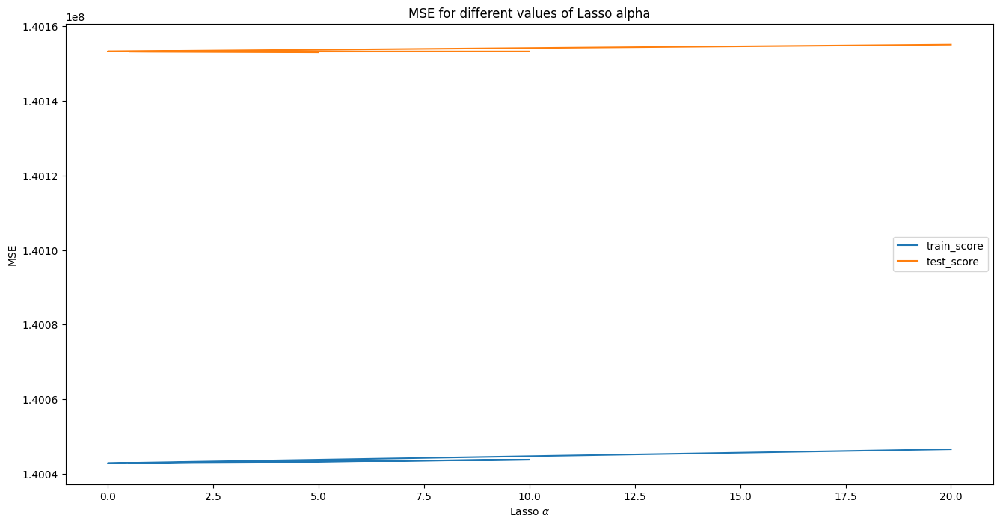

In [ ]:
plt.figure(figsize=(16,8))

# Remember, we need to do np.abs() of train and test score as they are negative in gridsearch CV
plt.plot(lasso_results['param_alpha'],np.abs(lasso_results['mean_train_score']), label = 'train_score')
plt.plot(lasso_results['param_alpha'],np.abs(lasso_results['mean_test_score']), label = 'test_score')


plt.ylabel('MSE')
plt.xlabel('Lasso $α$')
plt.title("MSE for different values of Lasso alpha")
plt.legend()
plt.show()

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine-tuning their inventory.